# Generic Imports and Config

In [2]:
import os
import glob
import h5py
import shutil 
from IPython.display import Audio, display
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from scipy.io import wavfile
import tensorflow as tf

%reload_ext autoreload
%autoreload 2

tf.__version__

'1.14.0'

In [3]:
import preprocess as preprocess

# config
preprocess.SUBSET = "test"
preprocess.OUTPUT = "./data/Songs/test_song"
preprocess.NOISE_DATAPATH = preprocess.DATA_PATH + '/Applause'
preprocess.NOISE_DATAPATH_TEST = preprocess.DATA_PATH + '/Applause_test'
preprocess.VORBIS_WINDOW = preprocess.vorbis_window(preprocess.WINDOW_LEN)

# Calculating Test song FFT 

In [5]:
def make_noisy_song(song_path):
    sr, song = wavfile.read(song_path)
    song_len = len(song)

    noisy_song = np.zeros(song_len)
    noise = np.zeros(song_len)
   
    for sl in range(song_len // preprocess.SLICE_STEP - 1):
        # get slices
        song_slice = song[sl * preprocess.SLICE_STEP: sl * preprocess.SLICE_STEP + preprocess.SLICE_DURATION * preprocess.SAMPLE_RATE]
        noisy_song_slice, noise_slice = preprocess.get_noisy_signal(song_slice)

        # get whole noise and noisy_song
        noise[sl * preprocess.SLICE_STEP: sl * preprocess.SLICE_STEP + preprocess.SLICE_DURATION * preprocess.SAMPLE_RATE] += noise_slice
        noisy_song[sl * preprocess.SLICE_STEP: sl * preprocess.SLICE_STEP + preprocess.SLICE_DURATION * preprocess.SAMPLE_RATE] += noisy_song_slice
    
    #save signals as wav
    path = song_path.split('mixture16.wav')[0]
    wavfile.write(path + 'noise.wav', sr, noise.astype("int16"))
    wavfile.write(path + 'noisy_song.wav', sr, noisy_song.astype("int16"))

    print("processed successfully")

In [6]:
def generating_noisy_song(song_path):
    sr, song = wavfile.read(song_path)
    song_len = len(song)

    noisy_song = np.zeros(song_len)
    noise = np.zeros(song_len)
   
    for sl in range(song_len // preprocess.SLICE_STEP - 1):
        # get slices
        song_slice = song[sl * preprocess.SLICE_STEP: sl * preprocess.SLICE_STEP + preprocess.SLICE_DURATION * preprocess.SAMPLE_RATE]
        noisy_song_slice, noise_slice = preprocess.get_noisy_signal(song_slice)

        # calculate fft magn and phase for each slice
        noisy_song_fft_magn = []
        noisy_song_fft_phase = []
        frame_count = len(noisy_song_slice) // preprocess.STEP - 1

        for i in range(frame_count):
            noisy_cur_window = noisy_song_slice[i * preprocess.STEP: i * preprocess.STEP + preprocess.WINDOW_LEN]
            noisy_magnitude, noisy_phase = preprocess.get_magn_phase(noisy_cur_window)
            # append
            noisy_song_fft_magn.append(noisy_magnitude)
            noisy_song_fft_phase.append(noisy_phase)

#         save as hdf5 files
        magn_file_path = preprocess.get_path(song_path, 'magnitude', sl)
        with h5py.File(magn_file_path, 'w') as hf:
            hf.create_dataset('dataset', data=np.asarray(noisy_song_fft_magn))

        phase_file_path = preprocess.get_path(song_path, 'phase', sl)
        with h5py.File(phase_file_path, 'w') as hf:
            hf.create_dataset('dataset', data=np.asarray(noisy_song_fft_phase))

        # get whole noise and noisy_song
        noise[sl * preprocess.SLICE_STEP: sl * preprocess.SLICE_STEP + preprocess.SLICE_DURATION * preprocess.SAMPLE_RATE] += noise_slice
        noisy_song[sl * preprocess.SLICE_STEP: sl * preprocess.SLICE_STEP + preprocess.SLICE_DURATION * preprocess.SAMPLE_RATE] += noisy_song_slice
    
    #save signals as wav
    path = song_path.split('mixture16.wav')[0]
    wavfile.write(path + 'noise.wav', sr, noise.astype("int16"))
    wavfile.write(path + 'noisy_song.wav', sr, noisy_song.astype("int16"))

    print("processed successfully")

In [7]:
test_song_path = './data/Songs/test_song/Carlos Gonzalez - A Place For Us/mixture16.wav'
sr = 16000

In [8]:
#generating_noisy_song(test_song_path)

In [29]:
sr, song = wavfile.read(test_song_path)

noise_path = './data/Songs/test_song/Carlos Gonzalez - A Place For Us/noise.wav'
sr, noise = wavfile.read(noise_path)

noisy_song_path = './data/Songs/test_song/Eric Clapton - Layla.wav'
# noisy_song_path = './data/Songs/test_song/Carlos Gonzalez - A Place For Us/noisy_song.wav'
sr, noisy_song = wavfile.read(noisy_song_path)

Song


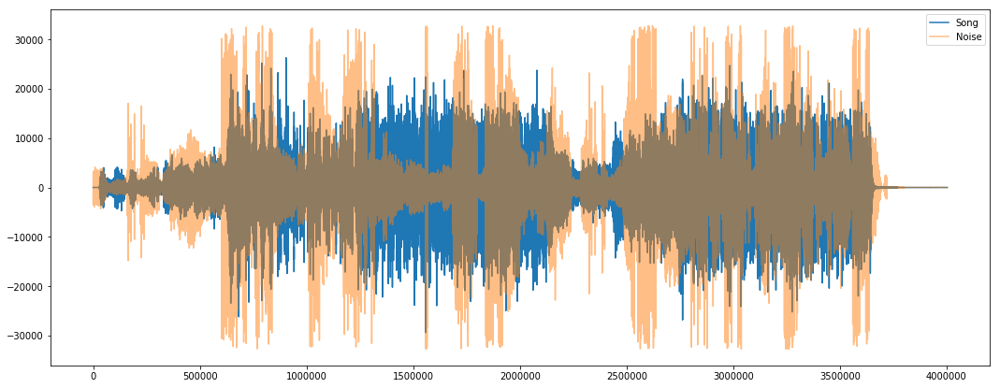

In [10]:
print("Song")
display(Audio(song, rate=sr))
fig, ax = plt.subplots(figsize=(18,7))
ax.plot(song, label="Song");
ax.plot(noise, label="Noise", alpha=0.5);
plt.legend(loc="upper right");



Noisy song


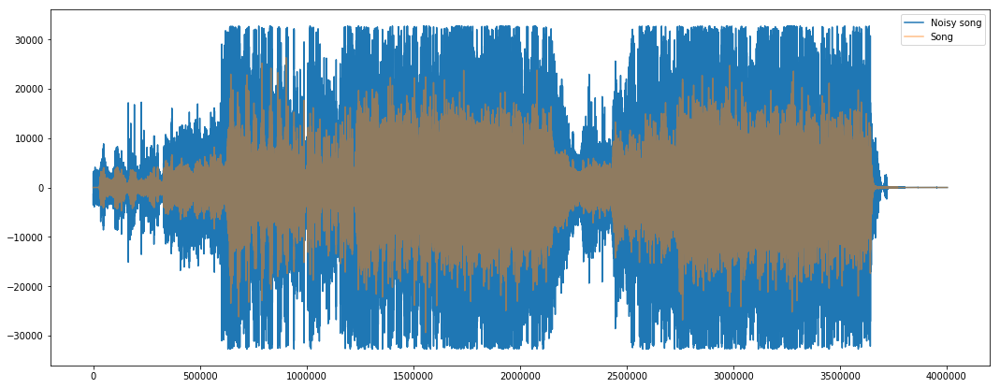

In [11]:
print("Noisy song")
display(Audio(noisy_song, rate=sr))
fig, ax = plt.subplots(figsize=(18,7))
ax.plot(noisy_song, label="Noisy song");
ax.plot(song, label="Song", alpha = 0.5);


plt.legend(loc="upper right");

In [0]:
print(noisy_song.shape)
song.shape

(4003500,)


(4003500,)

# Estimating Test song

In [23]:
!python3 main.py --mode 'test_song' --noisy_song_path './data/Songs/test_song/Eric Clapton - Layla.wav' --output_estimated_path './results/RNN'

/home/student/.local/lib/python3.5/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/student/.local/lib/python3.5/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/student/.local/lib/python3.5/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/student/.local/lib/python3.5/site-packages/tensorflow/python/framework/dtypes.py:5

W0424 18:11:03.626764 140682405295872 deprecation.py:323] From /home/student/.local/lib/python3.5/site-packages/tensorflow/python/training/saver.py:1276: checkpoint_exists (from tensorflow.python.training.checkpoint_management) is deprecated and will be removed in a future version.
Instructions for updating:
Use standard file APIs to check for files with this prefix.
I0424 18:11:03.628480 140682405295872 saver.py:1280] Restoring parameters from ./results/RNN/checkpoints/epoch.ckpt-3080
2020-04-24 18:11:03.670794: W tensorflow/compiler/jit/mark_for_compilation_pass.cc:1412] (One-time warning): Not using XLA:CPU for cluster because envvar TF_XLA_FLAGS=--tf_xla_cpu_global_jit was not set.  If you want XLA:CPU, either set that envvar, or use experimental_jit_scope to enable XLA:CPU.  To confirm that XLA is active, pass --vmodule=xla_compilation_cache=1 (as a proper command-line flag, not via TF_XLA_FLAGS) or set the envvar XLA_FLAGS=--xla_hlo_profile.
----Restore params----
----Test song h

In [26]:
# estimated_song_path = './results/RNN/noisy_song_estimated.wav'
estimated_song_path = './results/RNN/Eric Clapton - Layla_estimated.wav'
sr, estimated_song = wavfile.read(estimated_song_path)

Estimated Song


Song


Noisy song


error: ushort format requires 0 <= number <= (0x7fff * 2 + 1)

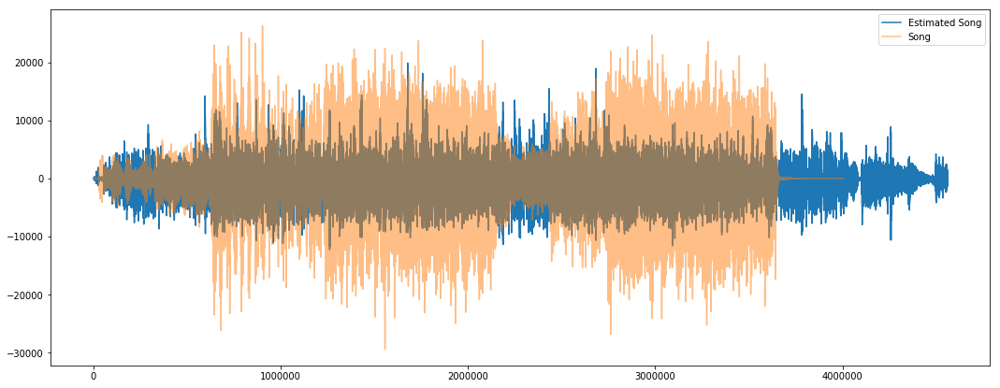

In [31]:
print("Estimated Song")
display(Audio(estimated_song, rate=sr))
print("Song")
display(Audio(song, rate=sr))

fig, ax = plt.subplots(figsize=(18,7))
ax.plot(estimated_song, label="Estimated Song");
ax.plot(song, label="Song", alpha=0.5);
plt.legend(loc="upper right");

print("Noisy song")
display(Audio(noisy_song, rate=sr))
fig, ax = plt.subplots(figsize=(18,7))
ax.set_ylim([-35000, 35000])
ax.plot(estimated_song, label="Estimated Song");
ax.plot(noisy_song, label="Noisy song", alpha = 0.7);
ax.plot(song, label="Song", alpha=0.3);

plt.legend(loc="upper right");